# How to Train YOLOv5 on Custom Objects

This tutorial is based on the [YOLOv5 repository](https://github.com/ultralytics/yolov5) by [Ultralytics](https://www.ultralytics.com/). This notebook shows training on **your own custom objects**. Many thanks to Ultralytics for putting this repository together - we hope that in combination with clean data management tools at Roboflow, this technologoy will become easily accessible to any developer wishing to use computer vision in their projects.

### Accompanying Blog Post

We recommend that you follow along in this notebook while reading the blog post on [how to train YOLOv5](https://blog.roboflow.ai/how-to-train-yolov5-on-a-custom-dataset/), concurrently.

### Steps Covered in this Tutorial

In this tutorial, we will walk through the steps required to train YOLOv5 on your custom objects. We use a [public blood cell detection dataset](https://public.roboflow.ai/object-detection/bccd), which is open source and free to use. You can also use this notebook on your own data.

To train our detector we take the following steps:

* Install YOLOv5 dependencies
* Download custom YOLOv5 object detection data
* Write our YOLOv5 Training configuration
* Run YOLOv5 training
* Evaluate YOLOv5 performance
* Visualize YOLOv5 training data
* Run YOLOv5 inference on test images
* Export saved YOLOv5 weights for future inference



### **About**

[Roboflow](https://roboflow.ai) enables teams to deploy custom computer vision models quickly and accurately. Convert data from to annotation format, assess dataset health, preprocess, augment, and more. It's free for your first 1000 source images.

#### ![Roboflow Workmark](https://i.imgur.com/WHFqYSJ.png)


#Install Dependencies

_(Remember to choose GPU in Runtime if not already selected. Runtime --> Change Runtime Type --> Hardware accelerator --> GPU)_

In [1]:


import torch
print(torch.cuda.get_device_properties(0))
from IPython.display import Image, clear_output  # to display images
from utils.google_utils import gdrive_download  # to download models/datasets


clear_output()
print('Setup complete. Using torch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))

AssertionError: 
The NVIDIA driver on your system is too old (found version 10010).
Please update your GPU driver by downloading and installing a new
version from the URL: http://www.nvidia.com/Download/index.aspx
Alternatively, go to: https://pytorch.org to install
a PyTorch version that has been compiled with your version
of the CUDA driver.

# Download Correctly Formatted Custom Dataset 

We'll download our dataset from Roboflow. Use the "**YOLOv5 PyTorch**" export format. Note that the Ultralytics implementation calls for a YAML file defining where your training and test data is. The Roboflow export also writes this format for us.

To get your data into Roboflow, follow the [Getting Started Guide](https://blog.roboflow.ai/getting-started-with-roboflow/).



![YOLOv5 PyTorch export](https://i.imgur.com/5vr9G2u.png)


In [33]:
# Export code snippet and paste here
!curl -L "https://app.roboflow.com/ds/Wo39PDEjSt?key=FLQx00MKzq" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip




  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   896  100   896    0     0    614      0  0:00:01  0:00:01 --:--:--   614
100  552M  100  552M    0     0  10.3M      0  0:00:53  0:00:53 --:--:-- 10.9M
Archive:  roboflow.zip
 extracting: test/images/FIANOXXX_row020B_0031_1_FSI_53223_54247_png.rf.0eaf6769b42789d116aba2691f1444f0.jpg  
 extracting: test/images/FSI_EILAT471_row002B_0012_7833_9037_png.rf.148d44231f98aba163a43f991b4288e6.jpg  
 extracting: test/images/EILAT831_row005A_0003_1_FSI_18139_19094_png.rf.22ad5fabf2ae84bdc3d02f5c120d5503.jpg  
 extracting: test/images/FALANGNA_row007B_0004_1_FSI_116692_117716_png.rf.15a2679f4ecaf58113fe3c6b3198ff01.jpg  
 extracting: test/images/EILAT832_row002B_0024_1_FSI_3137_4350_png.rf.1c8353e3d81265f612562f6a4d59b037.jpg  
 extracting: test/images/muskatxx_row010A_0003_1_FSI_32435_33459_png.rf.a23eca41f71b734644ccdf6e5131bf16.jpg  

 extracting: train/images/FSI_NERODETR_row058A_0030_1_sliced_raw_6307_8214_png.rf.05da89dac966259ac5b503c6d7475112.jpg  
 extracting: train/images/FSI_ARMOND47_row003A_0009_23246_25542_png.rf.0600ecabdd0b2c2dead9dd34b1163b39.jpg  
 extracting: train/images/EILAT832_row008A_0019_1_FSI_25161_26826_png.rf.05e463d099a2812d110439633334f5d3.jpg  
 extracting: train/images/FSI_GLERAxxx_ROW024A_0013_1_sliced_raw_73982_75518_png.rf.05f090e7e7aaeaf6323e19b5d7d39d9a.jpg  
 extracting: train/images/FSI_ARMOND47_row003B_0010_25972_28241_png.rf.06458047f14fb0fd61d94496bdf37ea6.jpg  
 extracting: train/images/muskatxx_row004B_0010_1_FSI_31594_32618_png.rf.063e21162bded75e00520dcb11f4c66c.jpg  
 extracting: train/images/MERLOTVP_ROW012B_0005_1_FSI_58558_59582_png.rf.05bb0472f8e3fd7970a6896e85383ea9.jpg  
 extracting: train/images/FALANGNA_row004B_0002_1_FSI_48008_49032_png.rf.062ec8ed0edd38bdfc93422f478b31a9.jpg  
 extracting: train/images/FIANOXXX_row004B_0008_1_FSI_42701_43725_png.rf.060cc5e0b4b2e46

 extracting: train/images/FSI_FR81BP16_row007A_0034_13593_14879_png.rf.0be94c4a19d24cd6b97ce4cba0d8f875.jpg  
 extracting: train/images/FSI_FIANOXXX_row024B_0030_6834_8699_png.rf.0bac34e27f92014d9ffb64c7acaeebd0.jpg  
 extracting: train/images/MERLOTVP_ROW012B_0005_1_FSI_58558_59582_png.rf.0bac966bf0bd797e1e5e371161c38981.jpg  
 extracting: train/images/FSI_NERODETR_row058B_0029_1_sliced_raw_50259_52194_png.rf.0bbf419423e64a8577535f72da298a87.jpg  
 extracting: train/images/FSI_ARMOND47_row003A_0009_11816_14107_png.rf.0be68418f163b49cb0f15e6a5c774811.jpg  
 extracting: train/images/EILAT832_row002B_0024_1_FSI_5538_6721_png.rf.0c208a7da58f3c35ae4675dbcdaed4ae.jpg  
 extracting: train/images/NERODETR_row018B_0008_1_FSI_27306_28330_png.rf.0bdb3a10f78cf69fd3b4007ab6c3a48e.jpg  
 extracting: train/images/FIANOXXX_row004A_0009_1_FSI_66840_67864_png.rf.0c2ebf61a979ea3d5a3ded5b096f2468.jpg  
 extracting: train/images/EILAT832_row005A_0021_1_FSI_14477_15542_png.rf.0c3d15db1c0e68c7cd43a5488a71f1

 extracting: train/images/FSI_FIANOXXX_row024A_0029_66123_68069_png.rf.11d8e4229d1a09823c7401a9a47f78e0.jpg  
 extracting: train/images/muskatxx_row006A_0007_1_FSI_6071_7095_png.rf.11ab19f3c26f947049c16f381cd27237.jpg  
 extracting: train/images/FSI_ARMOND47_row003A_0009_14107_16400_png.rf.11a840528efd960fb9e201bdc9400937.jpg  
 extracting: train/images/FSI_FIANOXXX_row024B_0030_6834_8699_png.rf.11c0cf6550fe740ad90f84a4b3c51941.jpg  
 extracting: train/images/FSI_ARMOND47_row003A_0009_11816_14107_png.rf.11b0391f67bef0370fb6e44b5c3d6ec3.jpg  
 extracting: train/images/muskatxx_row006A_0007_1_FSI_31414_32438_png.rf.11dc5f5fab95d3e2c6c7a622d1ef2275.jpg  
 extracting: train/images/MERLOTVP_ROW072B_0039_1_FSI_84747_85771_png.rf.120acc306179d947b073459039fcf264.jpg  
 extracting: train/images/MERLOTVP_ROW068A_0038_1_FSI_93476_94500_png.rf.120870ed68619d4300d892fcfb03104b.jpg  
 extracting: train/images/MERLOTVP_ROW008A_0004_1_FSI_87883_88907_png.rf.12231081c8fc5986e3bab754c7320441.jpg  
 ext

 extracting: train/images/EILAT831_row005B_0004_1_FSI_5579_6571_png.rf.17ca6a0116fe4cf1a965e078e9413e2d.jpg  
 extracting: train/images/FALANGNA_row004A_0001_1_FSI_82089_83113_png.rf.17c1189287e7d42d46d096a1c45ad74c.jpg  
 extracting: train/images/FSI_FR81BP16_row007B_0035_48168_49560_png.rf.17d49eb9c3acd62770fe160b59a7e7db.jpg  
 extracting: train/images/FSI_GLERAxxx_ROW028A_0015_4793_6376_png.rf.17b0498e3db463819ea8480ebd05f07f.jpg  
 extracting: train/images/FSI_muskatxx_row008A_0005_1_sliced_raw_30960_32152_png.rf.17f0adeafcd877568a2b11c2954f1f9a.jpg  
 extracting: train/images/muskatxx_row006A_0007_1_FSI_31414_32438_png.rf.17cee41f8e0a875a93b66c8f4b4272eb.jpg  
 extracting: train/images/FSI_EILAT471_row008A_0007_28434_30097_png.rf.17e07b8cc14df77ad1bd75dfc946be69.jpg  
 extracting: train/images/FSI_FR81BP16_row007A_0034_9582_10922_png.rf.17e0ade781488361d4d569425c0215e2.jpg  
 extracting: train/images/FSI_GLERAxxx_ROW028A_0015_4793_6376_png.rf.181ed33e5a80d5ecfee54778ffdd0ca5.jpg 

 extracting: train/images/FSI_FR84BP16_row006A_0005_43213_44678_png.rf.1e58072d68d5f5235ccdb58de5ff22c9.jpg  
 extracting: train/images/FSI_ARMOND47_row003B_0010_19256_21514_png.rf.1eb3fbd7a8395a96aa79996befe99977.jpg  
 extracting: train/images/EILAT832_row002A_0023_1_FSI_17967_19183_png.rf.1e7eebcac245442c41f7bdfb9d87ffa9.jpg  
 extracting: train/images/NERODETR_row010B_0004_1_FSI_5145_6169_png.rf.1e8ef1fff6ce93caac5669ece9c0f3ff.jpg  
 extracting: train/images/FSI_ARMOND47_row003B_0010_19256_21514_png.rf.1ea62237badb3fc732d407742ec46a25.jpg  
 extracting: train/images/FIANOXXX_row004B_0008_1_FSI_40730_41754_png.rf.1eb1bd359d4cfcc2cef7a62846712a64.jpg  
 extracting: train/images/FSI_FR841S16_row008A_0024_9262_10523_png.rf.1eb43d1ab3575dcfa08e36bb20211e5f.jpg  
 extracting: train/images/EILAT832_row002A_0023_1_FSI_19183_20403_png.rf.1edc0c831b5c5fef866f2fcb90e1a96e.jpg  
 extracting: train/images/FALANGNA_row004A_0001_1_FSI_9833_10857_png.rf.1ed52675b8c6af8b75c0c362f50a6a67.jpg  
 ext

 extracting: train/images/MERLOTVP_ROW068A_0038_1_FSI_88241_89265_png.rf.244139632277cc45775f885c6f217e30.jpg  
 extracting: train/images/FSI_NERODETR_row050B_0026_1_sliced_raw_6140_8017_png.rf.24acd7930dc546f51562ae2a43cc6582.jpg  
 extracting: train/images/FSI_EILAT471_row008B_0008_8321_9902_png.rf.24a80ae2e0ebb38892b85167521c4206.jpg  
 extracting: train/images/MERLOTVP_ROW012B_0005_1_FSI_40751_41775_png.rf.24c6a4ad3feb46dcb6ab8fd0a3b88b22.jpg  
 extracting: train/images/FSI_ARMOND47_row007A_0023_11402_12556_png.rf.24a9c39244992d36a6aa20e87feb926e.jpg  
 extracting: train/images/MERLOTVP_ROW072A_0040_1_FSI_9301_10325_png.rf.24ba0e1ee7d6c4ffa2b3cf4434126828.jpg  
 extracting: train/images/FALANGNA_row007B_0004_1_FSI_116127_117151_png.rf.24c98bcde3d32a53e3fccf64e3a472ab.jpg  
 extracting: train/images/FALANGNA_row004B_0002_1_FSI_48008_49032_png.rf.24c10944cf07e9ad13a317d225e3c73a.jpg  
 extracting: train/images/EILAT831_row005B_0004_1_FSI_5579_6571_png.rf.249774904376f60371b0cf9ae08dd

 extracting: train/images/FSI_FIANOXXX_row028B_0024_5474_7311_png.rf.2ae8e8a8e21037784c0581a8cbf4252c.jpg  
 extracting: train/images/muskatxx_row004B_0010_1_FSI_15851_16875_png.rf.2af93786cddc6b31ba204132c847dc32.jpg  
 extracting: train/images/EILAT832_row002B_0024_1_FSI_7901_9099_png.rf.2b1fc4f24f8ff8cc1353ccf570d6228f.jpg  
 extracting: train/images/MERLOTVP_ROW072B_0039_1_FSI_84747_85771_png.rf.2b02d252fd242679f075ef5dbe2d151c.jpg  
 extracting: train/images/NERODETR_row018B_0008_1_FSI_75919_76943_png.rf.2b0d0d8dca3f587b37953c03a8a7b276.jpg  
 extracting: train/images/FSI_EILAT471_row002B_0012_5320_6586_png.rf.2adaf4387c89ae773501c1d4cab0a517.jpg  
 extracting: train/images/FIANOXXX_row004B_0008_1_FSI_40730_41754_png.rf.2aff968e7286c9dfd066b45af9099362.jpg  
 extracting: train/images/FSI_FIANOXXX_row032A_0025_20366_22334_png.rf.2b25c74ca55b1f3b851be270d6ff9d3f.jpg  
 extracting: train/images/EILAT832_row008B_0020_1_FSI_5533_7086_png.rf.2b2c8396b53728fb21d1fa0ec3017b44.jpg  
 extra

 extracting: train/images/MERLOTVP_ROW012B_0005_1_FSI_16336_17360_png.rf.31dc5b5aec5f49de58c712676e6d0fac.jpg  
 extracting: train/images/FSI_FR841S16_row008A_0024_12967_14372_png.rf.3156a59848673e5c86b46f7af69fa9bb.jpg  
 extracting: train/images/FALANGNA_row004B_0002_1_FSI_23094_24118_png.rf.31e9915bf156289843faff15a9ac67fb.jpg  
 extracting: train/images/FIANOXXX_row012A_0013_1_FSI_67713_68737_png.rf.31ee22174f84fe180da87b9de36a8ab0.jpg  
 extracting: train/images/MERLOTVP_ROW072B_0039_1_FSI_55655_56679_png.rf.3214ba2bd21b336fcadb4252cd361167.jpg  
 extracting: train/images/FALANGNA_row007B_0004_1_FSI_105090_106114_png.rf.3207c1e5ed04c760802d0bc0dca1a2de.jpg  
 extracting: train/images/MERLOTVP_ROW012B_0005_1_FSI_58558_59582_png.rf.31b7bcd51f9bfa2c8c4e3f23d08afa78.jpg  
 extracting: train/images/FSI_EILAT471_row002B_0012_6586_7833_png.rf.31f9ab0fae8733859a844b528b2df4e4.jpg  
 extracting: train/images/FSI_ARMOND47_row003A_0009_7285_9548_png.rf.31b8366fc34f839c2260cda842b90e72.jpg  


 extracting: train/images/EILAT832_row002A_0023_1_FSI_17967_19183_png.rf.377dd65cac5dfc9b128a043ee923abf3.jpg  
 extracting: train/images/muskatxx_row010A_0003_1_FSI_21778_22802_png.rf.37c38f33ae96dac5db17ed69783fa1a1.jpg  
 extracting: train/images/FALANGNA_row004A_0001_1_FSI_105124_106148_png.rf.37ccf2649e4418272837a118b9f67e14.jpg  
 extracting: train/images/muskatxx_row010A_0003_1_FSI_21778_22802_png.rf.37f5d541023cddd753832a4ae4cc0b12.jpg  
 extracting: train/images/muskatxx_row006B_0008_1_FSI_5440_6464_png.rf.37d3ed066633feceb0a493d122297f88.jpg  
 extracting: train/images/NERODETR_row006A_0001_1_FSI_112499_113523_png.rf.37f1ac7e8c15bd57aa9c9d75645d0263.jpg  
 extracting: train/images/EILAT832_row008A_0019_1_FSI_28583_30307_png.rf.37d291522dd87d3ae475b54f3190acaa.jpg  
 extracting: train/images/FSI_EILAT471_row008B_0008_8321_9902_png.rf.37fff153ba0314d409666d9c42203b5e.jpg  
 extracting: train/images/FSI_MERLOTVP_ROW072B_0039_93619_95110_png.rf.380b6911dd056498abb091ea6f893b30.jp

 extracting: train/images/EILAT831_row005A_0003_1_FSI_14172_15178_png.rf.3e4aae84eae8cc10a4e4150d91ad9581.jpg  
 extracting: train/images/FSI_MERLOTVP_ROW036A_0020_1_sliced_raw_6027_7640_png.rf.3e1010eb0bbead8aa1f95cb05f99623a.jpg  
 extracting: train/images/FSI_ARMOND47_row007A_0023_12556_13697_png.rf.3e5295691102a8e9f986131eb1be9091.jpg  
 extracting: train/images/FSI_ARMOND47_row003B_0010_23761_25972_png.rf.3e5bcc4de9090a5e78a5965ff66292b7.jpg  
 extracting: train/images/FSI_FR841S16_row003B_0020_13088_14119_png.rf.3e1f8b0c902358128347166da493ab6e.jpg  
 extracting: train/images/FALANGNA_row007A_0003_1_FSI_124139_125163_png.rf.3e5834a91f845247caddc2dc578efa2a.jpg  
 extracting: train/images/EILAT832_row008A_0019_1_FSI_28583_30307_png.rf.3e7d6c67cc91dcbe40c8458e75b18379.jpg  
 extracting: train/images/MERLOTVP_ROW012B_0005_1_FSI_15213_16237_png.rf.3ebd54e799dba3244e710c5386ee2a3b.jpg  
 extracting: train/images/FSI_ARMOND47_row003A_0009_5038_7285_png.rf.3e75d2c96d2f97b41a8721e2348f23

 extracting: train/images/FSI_FR841S16_row003A_0019_34167_35508_png.rf.451d771089eb62f7bb0238b008d1a224.jpg  
 extracting: train/images/muskatxx_row006A_0007_1_FSI_31414_32438_png.rf.454d7922655235da593e14e906a5467c.jpg  
 extracting: train/images/MERLOTVP_ROW072B_0039_1_FSI_48370_49394_png.rf.455c9fb6ec267dac6e113a5c9c941825.jpg  
 extracting: train/images/FSI_NERODETR_row058A_0030_1_sliced_raw_6307_8214_png.rf.4580ef1b6fb42c40dcc194c3ee5e1d7c.jpg  
 extracting: train/images/FSI_FR841S16_row008B_0026_27072_28428_png.rf.45167fb1e45f2c64c33db1d23c86c1ba.jpg  
 extracting: train/images/FSI_FR84BP16_row006B_0006_7142_8659_png.rf.45aee812083a5ff7ecf381d6af286a7d.jpg  
 extracting: train/images/FIANOXXX_row008A_0010_1_FSI_128609_129633_png.rf.4553218897b4f9409847bc66eb13ee2c.jpg  
 extracting: train/images/FSI_NERODETR_row014A_0005_118492_120590_png.rf.4551100ef1f1d814447c2dd95a91102a.jpg  
 extracting: train/images/MERLOTVP_ROW012B_0005_1_FSI_40840_41864_png.rf.45c6e580e31533a86414599a9ad5

 extracting: train/images/FIANOXXX_row004B_0008_1_FSI_40730_41754_png.rf.4b9741117f22fa474f398c497f0a90ef.jpg  
 extracting: train/images/FSI_ARMOND47_row007B_0024_6453_7499_png.rf.4b672df660b4f170a6de15645349c073.jpg  
 extracting: train/images/FSI_MERLOTFC_row002B_0001_143606_145185_png.rf.4b9e3af89e41d3bc8530ff3d9acbb845.jpg  
 extracting: train/images/FSI_ARMOND47_row007A_0023_12556_13697_png.rf.4b59ee08fa06111b6f52e6698cc1efce.jpg  
 extracting: train/images/EILAT832_row005B_0022_1_FSI_6305_7336_png.rf.4c20c46045dbb1c705454665e9b9ba5a.jpg  
 extracting: train/images/MERLOTVP_ROW008B_0003_1_FSI_10743_11767_png.rf.4b91f3cf8f3209391bd148563c671aea.jpg  
 extracting: train/images/FIANOXXX_row008A_0010_1_FSI_114611_115635_png.rf.4bd7ff5ea7971b17fd7d444eaf00442d.jpg  
 extracting: train/images/EILAT831_row005A_0003_1_FSI_14172_15178_png.rf.4bdb3a5bb0d82085fb98019d7a60483a.jpg  
 extracting: train/images/NERODETR_row006B_0002_1_FSI_79237_80261_png.rf.4b9f0eae02d7f43dca2ee443f2869ef4.jpg 

 extracting: train/images/FSI_EILAT471_row002B_0012_5320_6586_png.rf.517f23b8ffc9e4f9b845b06ab2463b0e.jpg  
 extracting: train/images/muskatxx_row006B_0008_1_FSI_5274_6298_png.rf.516f1ef430db1d6cf6a6e8c5e143b858.jpg  
 extracting: train/images/NERODETR_row006B_0002_1_FSI_83886_84910_png.rf.5186588c47a94b2ee788ad79c4b4283b.jpg  
 extracting: train/images/FSI_RS22BP16_row011A_0025_6682_8330_png.rf.517a9e1e41aca4ec733f970f4a4923db.jpg  
 extracting: train/images/FALANGNA_row004B_0002_1_FSI_48008_49032_png.rf.518f2faac41485631899b5e07d961bd2.jpg  
 extracting: train/images/FSI_ARMOND47_row007A_0023_11402_12556_png.rf.5180481a1395a4e3e2b14bf28a479c18.jpg  
 extracting: train/images/muskatxx_row004B_0010_1_FSI_31594_32618_png.rf.51821b2798445738f1ea76c168df9f44.jpg  
 extracting: train/images/NERODETR_row010B_0004_1_FSI_61209_62233_png.rf.518a5c695a34030eda69cc5ee7a1cef4.jpg  
 extracting: train/images/MERLOTVP_ROW008A_0004_1_FSI_87883_88907_png.rf.51d944e9c46dcc2fabe0fd9effe40b3b.jpg  
 ext

 extracting: train/images/FALANGNA_row007A_0003_1_FSI_18389_19413_png.rf.57a767384506fb30237eed2f8c6d72cc.jpg  
 extracting: train/images/EILAT832_row008A_0019_1_FSI_23500_25161_png.rf.57b2855ac5284eba8a0921eb6b72623a.jpg  
 extracting: train/images/FSI_FR84BP16_row006A_0005_43213_44678_png.rf.57ea05818669ebaca1dcc94540cc98ba.jpg  
 extracting: train/images/EILAT831_row005A_0003_1_FSI_14172_15178_png.rf.58025d5a67320189b7aa53dd7c0e9912.jpg  
 extracting: train/images/FSI_muskatxx_row004A_0009_1_sliced_raw_28401_29588_png.rf.57e4ef96c6f0aeb20b134cb7daa5e6fc.jpg  
 extracting: train/images/MERLOTVP_ROW068A_0038_1_FSI_9258_10282_png.rf.57f809cbe6aaacea187409409de3f883.jpg  
 extracting: train/images/FIANOXXX_row012A_0013_1_FSI_67713_68737_png.rf.58073c4410f9ffb9a11c32bd89a002ff.jpg  
 extracting: train/images/FSI_FR81BP16_row007A_0034_12216_13593_png.rf.5808cf377f037ed9a00268ee5d92f2d5.jpg  
 extracting: train/images/FSI_FR84BP16_row006B_0006_7142_8659_png.rf.58274b77f17e1bf0ad049ffb3d494

 extracting: train/images/FSI_RS22BP16_row011A_0025_6682_8330_png.rf.5e17a4bfdbd4dc60ab1fe5b762e453a8.jpg  
 extracting: train/images/EILAT832_row002B_0024_1_FSI_7901_9099_png.rf.5df4008f9acf89cd46ef5e4c72a36afc.jpg  
 extracting: train/images/FSI_MERLOTVP_ROW036A_0020_1_sliced_raw_6027_7640_png.rf.5e10c9333c564b709b480c06e4a61d63.jpg  
 extracting: train/images/FALANGNA_row004A_0001_1_FSI_10530_11554_png.rf.5df9bec158508be54e18d2f614940fae.jpg  
 extracting: train/images/muskatxx_row006B_0008_1_FSI_17334_18358_png.rf.5e2e1b4c0311b07f93baafdfa6efabf9.jpg  
 extracting: train/images/FSI_FR841S16_row003A_0019_34167_35508_png.rf.5e25b8e21fe44eef42e1a2519c8cc112.jpg  
 extracting: train/images/FSI_NERODETR_row042B_0021_1_sliced_raw_6218_8092_png.rf.5e4cdb45a95b0cfee354575c80c010bf.jpg  
 extracting: train/images/MERLOTVP_ROW056B_0031_1_FSI_30867_31891_png.rf.5e5d458b24c750184130661ad691a701.jpg  
 extracting: train/images/FSI_FR81BP16_row007A_0034_12216_13593_png.rf.5e1986c0a0ce44c98fe66d7

 extracting: train/images/EILAT832_row005A_0021_1_FSI_15542_16596_png.rf.639e0c1af14886eb431494bcfdea01bc.jpg  
 extracting: train/images/FSI_FALANGNA_row007A_0003_1_sliced_raw_118620_120581_png.rf.6382f19c6c70ea70ce63ecc2d418cae9.jpg  
 extracting: train/images/EILAT471_row005A_0009_1_FSI_15047_16134_png.rf.63c4c86690fd9643ae98af2df2eb9e8b.jpg  
 extracting: train/images/FSI_ARMOND47_row003A_0009_9548_11816_png.rf.63b545c60c505798a269e7dc178be796.jpg  
 extracting: train/images/FSI_FR841S16_row003A_0019_31626_33004_png.rf.63ab2bea3086504002da58d027c5fa10.jpg  
 extracting: train/images/MERLOTVP_ROW076B_0041_1_FSI_95379_96403_png.rf.635abd0b80c5b5bf0efc3d3f92fd37f2.jpg  
 extracting: train/images/NERODETR_row014B_0006_1_FSI_88839_89863_png.rf.63cab350cd5966803eddd85b2bf08c35.jpg  
 extracting: train/images/muskatxx_row004B_0010_1_FSI_21125_22149_png.rf.63c35046d0158ba5e19b16e5dadfc7e0.jpg  
 extracting: train/images/FSI_ARMOND47_row007A_0023_4708_5808_png.rf.63dd5f493a5793f919a39eaf6ea

 extracting: train/images/MERLOTVP_ROW008A_0004_1_FSI_99462_100486_png.rf.69818a65c54525325422c99ef6921f64.jpg  
 extracting: train/images/FSI_MERLOTFC_row009A_0009_3875_5215_png.rf.698d0920ac8b2876079e40fbbb82da0f.jpg  
 extracting: train/images/FSI_EILAT471_row008A_0007_24925_26664_png.rf.69d39b4c84f55c90f97b9ea016f1e2e4.jpg  
 extracting: train/images/FSI_FR841S16_row008A_0024_11626_12967_png.rf.69a5df0c3e38d4d871ab8bd625ebd8f1.jpg  
 extracting: train/images/FSI_ARMOND47_row003A_0009_5038_7285_png.rf.697c8a0fd73f882399084438aad5ed59.jpg  
 extracting: train/images/muskatxx_row006A_0007_1_FSI_26820_27844_png.rf.69d918a37853a300b3d7ff9e3a02ddbc.jpg  
 extracting: train/images/FALANGNA_row007A_0003_1_FSI_124139_125163_png.rf.69b1942bd16567091197990d7e70dc8d.jpg  
 extracting: train/images/FSI_ARMOND47_row003B_0010_10339_12608_png.rf.69ddcf5a2f9a9cda51cba5ec931c9ee7.jpg  
 extracting: train/images/muskatxx_row006B_0008_1_FSI_5440_6464_png.rf.69a0678ac0192e0fbd7bdadce0312348.jpg  
 extr

 extracting: train/images/EILAT832_row008B_0020_1_FSI_7086_8631_png.rf.701d91eeba902d987f6280e456ec02ce.jpg  
 extracting: train/images/NERODETR_row014B_0006_1_FSI_95536_96560_png.rf.7013a89935e4fdea8df838f1c82e2b34.jpg  
 extracting: train/images/FSI_ARMOND47_row007A_0023_9170_10278_png.rf.702b570e82b5e78da60808a4e96ddd2a.jpg  
 extracting: train/images/FSI_MERLOTVP_ROW076A_0042_1_sliced_raw_4570_6042_png.rf.701e0f034707e933c5102aa7df2c61ac.jpg  
 extracting: train/images/FSI_muskatxx_row012B_0002_1_sliced_raw_4510_5625_png.rf.70265e40e2bb89a17736c5e09c25b62b.jpg  
 extracting: train/images/FSI_ARMOND47_row003B_0010_25972_28241_png.rf.7062e84a84861af56f42bf7da12455af.jpg  
 extracting: train/images/NERODETR_row014B_0006_1_FSI_95536_96560_png.rf.705a5cf17ced84ac978cb6dea8231509.jpg  
 extracting: train/images/FSI_MERLOTVP_ROW020A_0010_1_sliced_raw_4656_6282_png.rf.70786e17cc225286d0089c46996c0097.jpg  
 extracting: train/images/FALANGNA_row007B_0004_1_FSI_19902_20926_png.rf.7049590cc44

 extracting: train/images/EILAT832_row002B_0024_1_FSI_7901_9099_png.rf.762fcac78afe26cb35d7dfdaaf43ce55.jpg  
 extracting: train/images/EILAT832_row005A_0021_1_FSI_17685_18738_png.rf.7625d8d1c745a3e6a3af63a1b50e386c.jpg  
 extracting: train/images/EILAT471_row002A_0011_1_FSI_19900_21171_png.rf.7637d66af479b39a39635ae3ce059906.jpg  
 extracting: train/images/FIANOXXX_row020B_0031_1_FSI_43112_44136_png.rf.761c840cd5672c0e79203358b60d489d.jpg  
 extracting: train/images/FSI_MERLOTVP_ROW072B_0039_93619_95110_png.rf.764777b93735cda8a1eb237eca643a0c.jpg  
 extracting: train/images/FSI_MERLOTFC_row009A_0009_3875_5215_png.rf.7653946cc13738c750a1e7a901aaa5f1.jpg  
 extracting: train/images/FIANOXXX_row012A_0013_1_FSI_47729_48753_png.rf.766cfbe34e1f5e88169f782690c9965e.jpg  
 extracting: train/images/MERLOTVP_ROW076B_0041_1_FSI_95379_96403_png.rf.7654bff55323c4c72f5f762360a5464a.jpg  
 extracting: train/images/NERODETR_row018B_0008_1_FSI_75919_76943_png.rf.769044b1bea289e75eddc7a59f3e2378.jpg  


 extracting: train/images/EILAT832_row002A_0023_1_FSI_16752_17967_png.rf.7c8fefd82615f0616611d6299ee884ca.jpg  
 extracting: train/images/MERLOTVP_ROW004B_0001_1_FSI_58264_59288_png.rf.7c7c507cedb3f7eab0dda942df0d21bc.jpg  
 extracting: train/images/FSI_MERLOTVP_ROW072B_0039_93619_95110_png.rf.7c3701683864530f42dab06104b1f87a.jpg  
 extracting: train/images/FSI_FIANOXXX_row008B_0011_1_sliced_raw_6084_7934_png.rf.7ca0770e8b2729b41da4718b5bb7f6b9.jpg  
 extracting: train/images/EILAT471_row005A_0009_1_FSI_16134_17194_png.rf.7c4b0426c015cbe1afd91c94f2fca945.jpg  
 extracting: train/images/FSI_ARMOND47_row003A_0009_23246_25542_png.rf.7c5c2541be59e6b05364ba4a06f93c3a.jpg  
 extracting: train/images/FSI_FIANOXXX_row028B_0024_5474_7311_png.rf.7c7679d3e4357b34b9aac26c510b71d7.jpg  
 extracting: train/images/MERLOTVP_ROW012B_0005_1_FSI_4419_5443_png.rf.7c7dd131bb62e19d95d7b4463a52c037.jpg  
 extracting: train/images/EILAT832_row005A_0021_1_FSI_15542_16596_png.rf.7c8f640acd9ae4be1112c6595f573c99

 extracting: train/images/FIANOXXX_row004B_0008_1_FSI_47237_48261_png.rf.82ae42600286ea285c825c9f8564969a.jpg  
 extracting: train/images/FSI_FR841S16_row008B_0026_24573_25876_png.rf.82c3ad9b8422fa65f176431912b9f0bc.jpg  
 extracting: train/images/MERLOTVP_ROW012A_0006_1_FSI_33997_35021_png.rf.830ba464e0734c199bc8d549488c117b.jpg  
 extracting: train/images/muskatxx_row008A_0005_1_FSI_23530_24554_png.rf.8326e2a447436eaec2db9164831c64c4.jpg  
 extracting: train/images/EILAT832_row005A_0021_1_FSI_16596_17685_png.rf.831bbaad0b99f4263e4162352f77b806.jpg  
 extracting: train/images/FSI_EILAT471_row008A_0007_26664_28434_png.rf.8338141f369910d92b7410e3717f2001.jpg  
 extracting: train/images/FSI_muskatxx_row008A_0005_1_sliced_raw_30960_32152_png.rf.8228d0a9fbb372a3a788c1d095cc1826.jpg  
 extracting: train/images/EILAT831_row005A_0003_1_FSI_14172_15178_png.rf.832df97750aaffec14d7d1e7d08e251a.jpg  
 extracting: train/images/FSI_FR841S16_row008A_0024_12967_14372_png.rf.8304465932c08ed5f9c81df492

 extracting: train/images/FIANOXXX_row004B_0008_1_FSI_40730_41754_png.rf.8985508b689266cae3e0475fdc696c5d.jpg  
 extracting: train/images/NERODETR_row010B_0004_1_FSI_5145_6169_png.rf.89866e3082528e0454f43a6b597f677c.jpg  
 extracting: train/images/FSI_FIANOXXX_row028B_0024_5474_7311_png.rf.89892c022c03b824a1deb59a4a2f6af7.jpg  
 extracting: train/images/FSI_GLERAxxx_ROW028A_0015_4793_6376_png.rf.896e0b0ceee55653a2f516ee1477f160.jpg  
 extracting: train/images/FSI_ARMOND47_row003A_0009_16400_18657_png.rf.899466dea290badcd84824359a4a8d7d.jpg  
 extracting: train/images/EILAT832_row008B_0020_1_FSI_10170_11809_png.rf.898480ee7c77980bf26d087ba8ab605c.jpg  
 extracting: train/images/FSI_MERLOTVP_ROW072B_0039_93619_95110_png.rf.89c874197f346711e5985600fe9591df.jpg  
 extracting: train/images/EILAT832_row005A_0021_1_FSI_15542_16596_png.rf.899df30b1848629bb85320c2dfb7b3e3.jpg  
 extracting: train/images/FSI_ARMOND47_row007A_0023_6911_8045_png.rf.89a76f989165fbf60543cb507e224ea5.jpg  
 extractin

 extracting: train/images/FSI_MERLOTVP_ROW020A_0010_1_sliced_raw_4656_6282_png.rf.8ffe9d8bd6c5f9c86da1098462a02264.jpg  
 extracting: train/images/FSI_FR84BP16_row006A_0005_46208_47760_png.rf.902f07fdf841116462392aa7a06cf890.jpg  
 extracting: train/images/EILAT832_row008B_0020_1_FSI_7086_8631_png.rf.905e9721f03636726b39c5b6bed6dacc.jpg  
 extracting: train/images/FSI_FR81BP16_row007A_0034_10922_12216_png.rf.9030ed06282c2a384cace5a1db5c14be.jpg  
 extracting: train/images/FSI_ARMOND47_row003A_0009_9548_11816_png.rf.905bc4201166fe5634daaa26e2a45716.jpg  
 extracting: train/images/FALANGNA_row004A_0001_1_FSI_97216_98240_png.rf.903ae684512b4cf01b514a31aee8b422.jpg  
 extracting: train/images/FSI_NERODETR_row014A_0005_118492_120590_png.rf.906c3fa69cbe1e57bd382f4ed89f564d.jpg  
 extracting: train/images/FSI_ARMOND47_row003B_0010_8082_10339_png.rf.9045d0ab13f57deac73eb196a425a48a.jpg  
 extracting: train/images/FIANOXXX_row008A_0010_1_FSI_128609_129633_png.rf.9015f1e515d0d6df4159afea9e2cc0eb

 extracting: train/images/NERODETR_row006B_0002_1_FSI_66116_67140_png.rf.961bb0ef521559b2bd44b40e8fc7effd.jpg  
 extracting: train/images/MERLOTVP_ROW008A_0004_1_FSI_87883_88907_png.rf.965572be7404192a97fc56a010e90d7d.jpg  
 extracting: train/images/EILAT831_row005A_0003_1_FSI_14172_15178_png.rf.964781ba8be40a12c07f58c5b602c70f.jpg  
 extracting: train/images/FSI_muskatxx_row004A_0009_1_sliced_raw_28401_29588_png.rf.964053084d86c81c067a14b6d2fa62ae.jpg  
 extracting: train/images/FIANOXXX_row020B_0031_1_FSI_43112_44136_png.rf.9662bae9063156a1eb600ecd907dd3fc.jpg  
 extracting: train/images/MERLOTVP_ROW012A_0006_1_FSI_16141_17165_png.rf.965a8774a622e454f11792b374880baa.jpg  
 extracting: train/images/muskatxx_row010A_0003_1_FSI_21778_22802_png.rf.9637f72a94ece8e4fe70b49b9fcaf3fe.jpg  
 extracting: train/images/FSI_EILAT471_row008B_0008_8321_9902_png.rf.9674e6850b0a023695b6b9a0267bb527.jpg  
 extracting: train/images/FSI_ARMOND47_row003B_0010_25972_28241_png.rf.9653b5e90fe059df69bc29036f

 extracting: train/images/FSI_EILAT471_row008B_0008_9902_11502_png.rf.9caade482cb28885f7e85955ce4b0819.jpg  
 extracting: train/images/MERLOTVP_ROW008B_0003_1_FSI_13973_14997_png.rf.9c7cb8db9d6ce1f767c304cc521cf253.jpg  
 extracting: train/images/FIANOXXX_row012A_0013_1_FSI_47729_48753_png.rf.9c79d11f3ef2c4d1ef6e6d8fb630ef8f.jpg  
 extracting: train/images/EILAT832_row002B_0024_1_FSI_5538_6721_png.rf.9c1ebd8f5da8789ca4fce5ecf5b97575.jpg  
 extracting: train/images/EILAT832_row002A_0023_1_FSI_17967_19183_png.rf.9cb851941da9681bd68552e456f10aa6.jpg  
 extracting: train/images/FSI_muskatxx_row012B_0002_1_sliced_raw_4510_5625_png.rf.9ce13612b9237c328a28832d12cd39c6.jpg  
 extracting: train/images/FIANOXXX_row008A_0010_1_FSI_114611_115635_png.rf.9cf26df703cd65fbb8d5a7fc9ffff1a4.jpg  
 extracting: train/images/FSI_FR84BP16_row006A_0005_46208_47760_png.rf.9cb1d9a668b1b33d88d17dc01ae0e704.jpg  
 extracting: train/images/EILAT471_row002A_0011_1_FSI_19900_21171_png.rf.9cab1c23eade8d3bf468a28bade

 extracting: train/images/FSI_EILAT471_row008A_0007_26664_28434_png.rf.a33258268015242482bc5b5d436b0247.jpg  
 extracting: train/images/EILAT471_row002A_0011_1_FSI_18648_19900_png.rf.a3704bd705e4062e528560ed50376e91.jpg  
 extracting: train/images/MERLOTVP_ROW072B_0039_1_FSI_84747_85771_png.rf.a369192d18d46666576d20adacb72013.jpg  
 extracting: train/images/EILAT832_row008B_0020_1_FSI_10170_11809_png.rf.a36a76f684e99364b083d19478e825c3.jpg  
 extracting: train/images/MERLOTVP_ROW072B_0039_1_FSI_17837_18861_png.rf.a2e7bed8c8c57651bc6b0542e306f406.jpg  
 extracting: train/images/muskatxx_row004B_0010_1_FSI_31594_32618_png.rf.a36d1c40c0729449ece837021a2176ff.jpg  
 extracting: train/images/EILAT832_row005B_0022_1_FSI_7336_8308_png.rf.a370d6ca88833d754e0c0f7353821b6b.jpg  
 extracting: train/images/FSI_MERLOTVP_ROW076A_0042_1_sliced_raw_4570_6042_png.rf.a38d7269b1122c1ebc02ddc698efadad.jpg  
 extracting: train/images/FALANGNA_row007A_0003_1_FSI_18389_19413_png.rf.a35f7deda15c30ad36d9ac3a1e

 extracting: train/images/FSI_ARMOND47_row007B_0024_7499_8556_png.rf.a9a94d7756b05e394a12c855860a1c7f.jpg  
 extracting: train/images/FALANGNA_row007B_0004_1_FSI_116127_117151_png.rf.aa00afa9bc093683c60bdad72558c243.jpg  
 extracting: train/images/FSI_muskatxx_row008A_0005_1_sliced_raw_30960_32152_png.rf.a9c8bb988f529a84f13ca0ad92114d59.jpg  
 extracting: train/images/EILAT832_row008B_0020_1_FSI_3925_5533_png.rf.aa0352823b7dce279d97fd25ef1012c1.jpg  
 extracting: train/images/EILAT471_row005A_0009_1_FSI_15047_16134_png.rf.a9da78d28c40f3dcc7a19e52d7919db4.jpg  
 extracting: train/images/NERODETR_row018B_0008_1_FSI_117780_118804_png.rf.a9db5fe4f6e2c92d2b4cf605c7bd3cab.jpg  
 extracting: train/images/FSI_FALANGNA_row007A_0003_1_sliced_raw_118620_120581_png.rf.a97347f3cf74bd7c33a6fee4c4e01e0c.jpg  
 extracting: train/images/FSI_FR841S16_row003A_0019_31626_33004_png.rf.aa0ff68fbf5beb664a978280a2021010.jpg  
 extracting: train/images/FSI_ARMOND47_row007B_0024_3213_4309_png.rf.a9ccc43a9feb0d7

 extracting: train/images/FSI_FR81BP16_row007B_0035_46715_48168_png.rf.b0257d20b32149c6d0c23cb0aca27896.jpg  
 extracting: train/images/FSI_ARMOND47_row003B_0010_23761_25972_png.rf.b05ddaea293bdcb1baec9872e49018d9.jpg  
 extracting: train/images/FSI_ARMOND47_row003A_0009_7285_9548_png.rf.b00efcf9f43b0c5d5db158b98a013499.jpg  
 extracting: train/images/FSI_EILAT471_row005B_0010_7342_8414_png.rf.b054f00f7305399dd7e2e7283d9b6d4f.jpg  
 extracting: train/images/FALANGNA_row004A_0001_1_FSI_77754_78778_png.rf.b07d45b18c7fa1e602c2617278b2113d.jpg  
 extracting: train/images/FIANOXXX_row004B_0008_1_FSI_42701_43725_png.rf.b03531bff6fd999c287f39aa559a766b.jpg  
 extracting: train/images/FSI_FR81BP16_row007A_0034_12216_13593_png.rf.b06953cbec27774a34fbce5e72ddbffd.jpg  
 extracting: train/images/EILAT471_row005A_0009_1_FSI_13964_15047_png.rf.b05b715832195f22822ca12577dac917.jpg  
 extracting: train/images/FALANGNA_row007A_0003_1_FSI_62070_63094_png.rf.b03130dd87930026b8b365e9256e84df.jpg  
 extra

 extracting: train/images/FALANGNA_row007A_0003_1_FSI_3541_4565_png.rf.b6ecf659e10003f2f151974a32f45839.jpg  
 extracting: train/images/EILAT831_row005A_0003_1_FSI_16175_17152_png.rf.b6d796789d3899bfdb9e01df27ee80ef.jpg  
 extracting: train/images/FSI_ARMOND47_row007A_0023_4708_5808_png.rf.b6fcfa903198659f2e99449e187810eb.jpg  
 extracting: train/images/FSI_NERODETR_row058A_0030_1_sliced_raw_6307_8214_png.rf.b6e21096965d5186b65695b52ae44c76.jpg  
 extracting: train/images/MERLOTVP_ROW072B_0039_1_FSI_12062_13086_png.rf.b7063fa64d8e854fff0f3bbfd0afcaa0.jpg  
 extracting: train/images/FSI_ARMOND47_row003B_0010_19256_21514_png.rf.b738bc3c7c0f9bff0c7e8647817cdd23.jpg  
 extracting: train/images/FIANOXXX_row004B_0008_1_FSI_47237_48261_png.rf.b718673456448a463e01b2dfbc22b0e5.jpg  
 extracting: train/images/NERODETR_row018B_0008_1_FSI_117780_118804_png.rf.b74c4ae765ef789edaab05fefd32e0a0.jpg  
 extracting: train/images/FSI_ARMOND47_row003A_0009_23246_25542_png.rf.b72bd9585bfab5584e65555850f74f

 extracting: train/images/FSI_NERODETR_row050B_0026_1_sliced_raw_6140_8017_png.rf.bcd4beaebceb0d9efd77ae761ddf44a1.jpg  
 extracting: train/images/FSI_ARMOND47_row003B_0010_19256_21514_png.rf.bccacba6d2dface744c065c5f8e5f2b1.jpg  
 extracting: train/images/FSI_ARMOND47_row003B_0010_12608_14858_png.rf.bce8cc42e86bcc20841f087eb8f96448.jpg  
 extracting: train/images/FSI_FR81BP16_row007A_0034_10922_12216_png.rf.bccfbb3dd016a445e61878b2ec13fcc9.jpg  
 extracting: train/images/FSI_FR81BP16_row007B_0035_46715_48168_png.rf.bd20989ef37589e8153ac2270c444361.jpg  
 extracting: train/images/FIANOXXX_row008A_0010_1_FSI_128609_129633_png.rf.bd308855b978d23c3d1b79feb8184759.jpg  
 extracting: train/images/FALANGNA_row004A_0001_1_FSI_77754_78778_png.rf.bd1fd96bd6272368b30cec88db640578.jpg  
 extracting: train/images/MERLOTVP_ROW008A_0004_1_FSI_87883_88907_png.rf.bd253755b3026e7522f7a091b7da5c3c.jpg  
 extracting: train/images/NERODETR_row006B_0002_1_FSI_66116_67140_png.rf.bd550fc49c392cb53f742fec44fa

 extracting: train/images/NERODETR_row006A_0001_1_FSI_112499_113523_png.rf.c259a5f6fa689c8860514a44dbfd41c7.jpg  
 extracting: train/images/MERLOTVP_ROW008B_0003_1_FSI_13973_14997_png.rf.c2981a581cd06d1c0837e3564739e996.jpg  
 extracting: train/images/FIANOXXX_row008A_0010_1_FSI_128609_129633_png.rf.c290783398f1e474cf84afe50e530a0a.jpg  
 extracting: train/images/MERLOTVP_ROW072B_0039_1_FSI_48370_49394_png.rf.c2c7e6bf85c9847b51406a65775c28da.jpg  
 extracting: train/images/FSI_ARMOND47_row007B_0024_7499_8556_png.rf.c26ffeab0202f79e5cc3d5139efdce0a.jpg  
 extracting: train/images/FSI_EILAT471_row005B_0010_5212_6286_png.rf.c2bc3800e59b87a66ad23ba724cdeb42.jpg  
 extracting: train/images/MERLOTVP_ROW068A_0038_1_FSI_88241_89265_png.rf.c2867d4c4ab7e720fde44299b3f17b00.jpg  
 extracting: train/images/FSI_FR81BP16_row007A_0034_13593_14879_png.rf.c2a3ace0237d15fffbc283082f3b2206.jpg  
 extracting: train/images/FSI_ARMOND47_row003A_0009_7285_9548_png.rf.c2c6331066939d7e4b0b54f71592686f.jpg  
 e

 extracting: train/images/NERODETR_row006B_0002_1_FSI_79237_80261_png.rf.c9362b1ef1300168892228abf8716e34.jpg  
 extracting: train/images/FSI_MERLOTFC_row009A_0009_3875_5215_png.rf.c9453650fd35601d0cf770ae9ed3fe58.jpg  
 extracting: train/images/MERLOTVP_ROW016A_0008_1_FSI_11126_12150_png.rf.c93a8844e87bc916c59f68f10cd3504f.jpg  
 extracting: train/images/FSI_ARMOND47_row007B_0024_7499_8556_png.rf.c8c5cbad28858f042a2bd928565c0d83.jpg  
 extracting: train/images/EILAT832_row008B_0020_1_FSI_5533_7086_png.rf.c9517e339f079637d4f078aececc050d.jpg  
 extracting: train/images/EILAT832_row005A_0021_1_FSI_17685_18738_png.rf.c954c446f50f0ecd44890fa7bf883807.jpg  
 extracting: train/images/MERLOTVP_ROW008B_0003_1_FSI_13973_14997_png.rf.c95b3cc40bebe0c25be650ce597b0574.jpg  
 extracting: train/images/FSI_FIANOXXX_row032A_0025_20366_22334_png.rf.c96ccb5828c3c43cd58a61c912c99e0a.jpg  
 extracting: train/images/FSI_MERLOTVP_ROW020B_0009_1_sliced_raw_51931_53610_png.rf.c9909995548224dc73e2039e1afa4606

 extracting: train/images/MERLOTVP_ROW024A_0013_1_FSI_25994_27018_png.rf.cf94d3a9d6050253a5028e8dce5b9a26.jpg  
 extracting: train/images/MERLOTVP_ROW072A_0040_1_FSI_43640_44664_png.rf.cf3d68d8b8c709e48cf0ba2bc36fcf94.jpg  
 extracting: train/images/EILAT832_row008A_0019_1_FSI_23500_25161_png.rf.cf954c22c94618bf14c668047bb231e6.jpg  
 extracting: train/images/MERLOTVP_ROW016A_0008_1_FSI_11126_12150_png.rf.cf211ed8fe24ecb3d12c4b4f78aabf79.jpg  
 extracting: train/images/EILAT832_row002A_0023_1_FSI_17967_19183_png.rf.cf75e0cc80f42dfbdd9b6709cb91f532.jpg  
 extracting: train/images/MERLOTVP_ROW012B_0005_1_FSI_15213_16237_png.rf.cfa90f506c8b9f56685b97c90f229cd5.jpg  
 extracting: train/images/EILAT831_row005B_0004_1_FSI_5579_6571_png.rf.cfcaaa3097caa20ab2eba3c0c673dd3c.jpg  
 extracting: train/images/FSI_ARMOND47_row003A_0009_11816_14107_png.rf.cf9cf5cca17e38ca3527c3d3e662e61a.jpg  
 extracting: train/images/FSI_ARMOND47_row003B_0010_10339_12608_png.rf.cfdabe135fd033b76ddd03f717181de8.jpg 

 extracting: train/images/FSI_MERLOTVP_ROW020B_0009_1_sliced_raw_51931_53610_png.rf.d6547ce5a6ad29ee5be6dc682363e3ae.jpg  
 extracting: train/images/FIANOXXX_row004B_0008_1_FSI_47237_48261_png.rf.d687a451aad58541368e06cd0f6a60df.jpg  
 extracting: train/images/FSI_NERODETR_row058A_0030_1_sliced_raw_6307_8214_png.rf.d6523c2a45513851ddd730f1c68694cd.jpg  
 extracting: train/images/FSI_RS22BP16_row011A_0025_8330_9914_png.rf.d6ba59b99b896af150e438fb10edd9dc.jpg  
 extracting: train/images/EILAT832_row002B_0024_1_FSI_4350_5538_png.rf.d633004d54ec64e47555bf71334d1328.jpg  
 extracting: train/images/EILAT471_row002A_0011_1_FSI_16060_17366_png.rf.d6b05a9bbf946f686a0a48505a8b4d9d.jpg  
 extracting: train/images/FSI_MERLOTVP_ROW072B_0039_93619_95110_png.rf.d6ac03ca8796c91e9f094e41ad7dbb43.jpg  
 extracting: train/images/FSI_muskatxx_row004A_0009_1_sliced_raw_28401_29588_png.rf.d66afd37282df2cc41aaa0533b85674e.jpg  
 extracting: train/images/EILAT832_row005B_0022_1_FSI_6305_7336_png.rf.d6be05f176

 extracting: train/images/FSI_MERLOTVP_ROW072B_0039_93619_95110_png.rf.dd94076e28269b4e640d458d156dabef.jpg  
 extracting: train/images/MERLOTVP_ROW004B_0001_1_FSI_7004_8028_png.rf.dd90bafa81be9ac660b28c43148b61bd.jpg  
 extracting: train/images/muskatxx_row010A_0003_1_FSI_21778_22802_png.rf.ddd7370209457fcd8e933cd31bf719ab.jpg  
 extracting: train/images/muskatxx_row008A_0005_1_FSI_23530_24554_png.rf.dd5825ec8a15f2518b023fc6132f7261.jpg  
 extracting: train/images/EILAT832_row008B_0020_1_FSI_3925_5533_png.rf.dd74a7810c0e53c15a22ff4216e8763b.jpg  
 extracting: train/images/FSI_FIANOXXX_row024A_0029_66123_68069_png.rf.dd752dff35c1869df301e33516546e19.jpg  
 extracting: train/images/FSI_EILAT471_row008B_0008_5130_6745_png.rf.dda8245acfd445c56edd37128787665e.jpg  
 extracting: train/images/NERODETR_row010B_0004_1_FSI_5145_6169_png.rf.dd83055f6211a656344ff7d9db56c0b3.jpg  
 extracting: train/images/EILAT832_row005A_0021_1_FSI_13431_14477_png.rf.ddbf64e4963a923d310436572f63e855.jpg  
 extra

 extracting: train/images/FALANGNA_row004B_0002_1_FSI_48008_49032_png.rf.e2f0104a411ce6e6edaa80f52276cd1e.jpg  
 extracting: train/images/MERLOTVP_ROW008A_0004_1_FSI_87883_88907_png.rf.e37c7fa51bb17487efda314f216546e2.jpg  
 extracting: train/images/FSI_ARMOND47_row003A_0009_7285_9548_png.rf.e3745f90d7ca53aa4411b4a68598002f.jpg  
 extracting: train/images/FALANGNA_row004B_0002_1_FSI_47843_48867_png.rf.e22cffbf8157d11e419ead31dbd9b2bb.jpg  
 extracting: train/images/FSI_ARMOND47_row003A_0009_11816_14107_png.rf.e386d6762bee1dd0673f0a73f4617698.jpg  
 extracting: train/images/FSI_FR841S16_row008A_0024_12967_14372_png.rf.e37b4d79b0601ccad82630bb69b85574.jpg  
 extracting: train/images/FSI_FR841S16_row008B_0026_27072_28428_png.rf.e3906cb16ae36f0ea8ebf9bf1a237e95.jpg  
 extracting: train/images/FSI_EILAT471_row002B_0012_5320_6586_png.rf.e3af9b04a96252a677c73ecf41441955.jpg  
 extracting: train/images/MERLOTVP_ROW012B_0005_1_FSI_40840_41864_png.rf.e3afa9689f7a6e001c57078e9c434004.jpg  
 extra

 extracting: train/images/FALANGNA_row004B_0002_1_FSI_48008_49032_png.rf.e93cd7f9e952265c6c56ff63fd99bfe7.jpg  
 extracting: train/images/MERLOTVP_ROW012A_0006_1_FSI_33997_35021_png.rf.e945a02746ec8290c0462d9f2ab32cfc.jpg  
 extracting: train/images/EILAT832_row002B_0024_1_FSI_4350_5538_png.rf.e9645d054f0c45a75e6b5b3bbde99579.jpg  
 extracting: train/images/FSI_EILAT471_row008B_0008_9902_11502_png.rf.e96247686bc01b909f5396bf8bf7ab43.jpg  
 extracting: train/images/FSI_FIANOXXX_row032A_0025_20366_22334_png.rf.e9773f0bab38c6acff5a4309dff3c8d7.jpg  
 extracting: train/images/FSI_EILAT471_row005B_0010_4153_5212_png.rf.e957716d2a52d65a035b285aa83a50ed.jpg  
 extracting: train/images/MERLOTVP_ROW016A_0008_1_FSI_11126_12150_png.rf.e9c0c4c026bc8e8cd39b00289a9c2a7f.jpg  
 extracting: train/images/FSI_GLERAxxx_ROW028A_0015_4793_6376_png.rf.e991bbedddd52fe24d2da0a77c15c4c7.jpg  
 extracting: train/images/FSI_GLERAxxx_ROW024A_0013_1_sliced_raw_73982_75518_png.rf.e9c3c6c5e795a9045730387fd82c137e.jp

 extracting: train/images/FSI_NERODETR_row014A_0005_118492_120590_png.rf.f01a2a171a0817b16d86ad9a30e15903.jpg  
 extracting: train/images/EILAT832_row005A_0021_1_FSI_14477_15542_png.rf.efe2ee00779b7d7cbd52fd8127cd64d2.jpg  
 extracting: train/images/FIANOXXX_row012A_0013_1_FSI_41122_42146_png.rf.f0141e4416545d40d2abb535fb36ce66.jpg  
 extracting: train/images/FSI_RS22BP16_row011A_0025_6682_8330_png.rf.eff9c26f4581f59e74d1f1d6edbde04c.jpg  
 extracting: train/images/EILAT471_row002A_0011_1_FSI_16060_17366_png.rf.f01ebb48753ef51a2b023f60147b1fc7.jpg  
 extracting: train/images/EILAT832_row005B_0022_1_FSI_4298_5297_png.rf.f02ad308be5683926957908a64ae6e72.jpg  
 extracting: train/images/FSI_ARMOND47_row007B_0024_6453_7499_png.rf.f02968c586215ff8dbbe4423f6aabad0.jpg  
 extracting: train/images/FSI_GLERAxxx_ROW024A_0013_1_sliced_raw_73982_75518_png.rf.efe47ab154a48d3285ba58cf48d82d6f.jpg  
 extracting: train/images/FSI_EILAT471_row005B_0010_3114_4153_png.rf.f0577db526cc55541571fc13cc73da8b.j

 extracting: train/images/FSI_MERLOTFC_row009A_0009_3875_5215_png.rf.f678a590e99ecb77a21ff512093d6ed9.jpg  
 extracting: train/images/FSI_ARMOND47_row003B_0010_25972_28241_png.rf.f67bee73a469372bd6ee7f53409e7b06.jpg  
 extracting: train/images/FSI_FR84BP16_row006B_0006_7142_8659_png.rf.f680af7454d2e18f272f04944f7ef78e.jpg  
 extracting: train/images/FALANGNA_row004A_0001_1_FSI_82089_83113_png.rf.f6854592180c8ead4260de52d9dd4edd.jpg  
 extracting: train/images/FSI_MERLOTVP_ROW020B_0009_1_sliced_raw_51931_53610_png.rf.f68d618304be4e427e7719664aed05a6.jpg  
 extracting: train/images/FSI_GLERAxxx_ROW012B_0007_5843_7430_png.rf.f6b1e8df3198d6d6d8099668c3fd6833.jpg  
 extracting: train/images/MERLOTVP_ROW072A_0040_1_FSI_9301_10325_png.rf.f6a8e3ce730c460bc70bfdec0516d4fe.jpg  
 extracting: train/images/FSI_EILAT471_row008A_0007_28434_30097_png.rf.f6b5765765f0eeeacbb9eb4413bc6c41.jpg  
 extracting: train/images/EILAT832_row005B_0022_1_FSI_6305_7336_png.rf.f6c39835d74b390beeab42d81f3c3909.jpg  


 extracting: train/images/MERLOTVP_ROW004B_0001_1_FSI_26963_27987_png.rf.fcf4c5daa720cae606b3d8885bd3a492.jpg  
 extracting: train/images/FSI_ARMOND47_row003B_0010_12608_14858_png.rf.fceb592e45509633e921cdbf7ee972be.jpg  
 extracting: train/images/muskatxx_row004B_0010_1_FSI_15851_16875_png.rf.fce01f2189ebe4fead29f6efe2ac1a9e.jpg  
 extracting: train/images/EILAT832_row005A_0021_1_FSI_15542_16596_png.rf.fcea279369c302cda137bbe8b03dcb49.jpg  
 extracting: train/images/FALANGNA_row004B_0002_1_FSI_47843_48867_png.rf.fcfe7339a6bb76599257ccdb43614d9b.jpg  
 extracting: train/images/FSI_ARMOND47_row007B_0024_3213_4309_png.rf.fcf6cfe1d2e6418b27180c47c25dd193.jpg  
 extracting: train/images/FALANGNA_row004A_0001_1_FSI_9833_10857_png.rf.fcf3ed475b42745975533862c395b9df.jpg  
 extracting: train/images/FSI_RS22BP16_row011A_0025_8330_9914_png.rf.fd338c12334905fb2ac0900872e34d9f.jpg  
 extracting: train/images/EILAT832_row005B_0022_1_FSI_6305_7336_png.rf.fd509a1d470caf365ef2557ba24400b9.jpg  
 extr

 extracting: train/labels/FSI_FR841S16_row003B_0020_14119_15467_png.rf.14e8a74768fb0514f4987e9d1fb38e24.txt  
 extracting: train/labels/FSI_FR841S16_row008A_0024_12967_14372_png.rf.148754b68ba3aa9eae6f38f3e5b03438.txt  
 extracting: train/labels/muskatxx_row006B_0008_1_FSI_5440_6464_png.rf.14e5344c507dfbfaca28b61d3b8d323f.txt  
 extracting: train/labels/FSI_ARMOND47_row007A_0023_9170_10278_png.rf.14f753d74c1f1f998d1759c2443e5b45.txt  
 extracting: train/labels/FSI_FR841S16_row003A_0019_31626_33004_png.rf.1505ac90eda2cc344aba74c9c28f7a4c.txt  
 extracting: train/labels/FSI_ARMOND47_row003B_0010_12608_14858_png.rf.14d07a2adfb61e2f3ae3f0804759d469.txt  
 extracting: train/labels/FALANGNA_row007B_0004_1_FSI_105090_106114_png.rf.1504b22bf86b6acd6ab6e0d115121627.txt  
 extracting: train/labels/NERODETR_row018B_0008_1_FSI_27306_28330_png.rf.1490281aa4a1fa2bc33ee368868df3bb.txt  
 extracting: train/labels/FSI_FR841S16_row003A_0019_31626_33004_png.rf.150f141d7b0145df40b983e64b9e24b0.txt  
 extr

 extracting: train/labels/muskatxx_row006A_0007_1_FSI_31414_32438_png.rf.44d0e309b58d53c672a97e689cf6966a.txt  
 extracting: train/labels/FSI_muskatxx_row008A_0005_1_sliced_raw_30960_32152_png.rf.44fffd4047ecdf1a1ba19d4531089499.txt  
 extracting: train/labels/EILAT832_row005B_0022_1_FSI_4298_5297_png.rf.451d9e793212518d4d33eb2c46364066.txt  
 extracting: train/labels/FALANGNA_row004A_0001_1_FSI_82089_83113_png.rf.44f406b04c59aa22e2f206f9846994d9.txt  
 extracting: train/labels/NERODETR_row018B_0008_1_FSI_117780_118804_png.rf.4547935f28af8535040ac141643752d3.txt  
 extracting: train/labels/FSI_EILAT471_row008A_0007_28434_30097_png.rf.454ef8429776cf3c32caa6a4cc19c0b9.txt  
 extracting: train/labels/FALANGNA_row007A_0003_1_FSI_62070_63094_png.rf.454e3f9d250494af8267e130493e0466.txt  
 extracting: train/labels/MERLOTVP_ROW072A_0040_1_FSI_71046_72070_png.rf.45842d37ee9452c1eeed6c30d33ef147.txt  
 extracting: train/labels/EILAT832_row008B_0020_1_FSI_3925_5533_png.rf.459b680dc7f35e76a89de7a3

 extracting: train/labels/FSI_EILAT471_row008B_0008_5130_6745_png.rf.72f6fb256212ff60483b77d334146159.txt  
 extracting: train/labels/MERLOTVP_ROW012B_0005_1_FSI_40840_41864_png.rf.72df1ae55c2c29f15b866f1abf28634d.txt  
 extracting: train/labels/NERODETR_row018B_0008_1_FSI_75919_76943_png.rf.72eedcd5798be922438eb1d67c1c0cc7.txt  
 extracting: train/labels/muskatxx_row006B_0008_1_FSI_17334_18358_png.rf.72e96d95572bd72f3452d78a972ca004.txt  
 extracting: train/labels/FSI_FR84BP16_row006B_0006_7142_8659_png.rf.72af37a01c95d737b66d1c0e9e1d7741.txt  
 extracting: train/labels/FSI_FR84BP16_row006B_0006_7142_8659_png.rf.72fdb71bf6aef88ad4c586b82e88bd0f.txt  
 extracting: train/labels/FSI_EILAT471_row008B_0008_8321_9902_png.rf.73325c31b0931c9076d10575d2089aad.txt  
 extracting: train/labels/FSI_NERODETR_row026A_0011_1_sliced_raw_112061_114350_png.rf.73145d50e20426ced3c0bcbf971b49eb.txt  
 extracting: train/labels/muskatxx_row004B_0010_1_FSI_31594_32618_png.rf.730d44654d20e053885a040349f024b7.t

 extracting: train/labels/FSI_EILAT471_row005B_0010_6286_7342_png.rf.a2c95a4a60a64e5c5bf91a289be56a18.txt  
 extracting: train/labels/FALANGNA_row004A_0001_1_FSI_105124_106148_png.rf.a29a47b691749aef89ff6a2a7f3649e8.txt  
 extracting: train/labels/FSI_FIANOXXX_row016B_0017_1_sliced_raw_6628_8554_png.rf.a2acf229c9b77d99165ca92a920362d6.txt  
 extracting: train/labels/NERODETR_row006A_0001_1_FSI_112499_113523_png.rf.a2f96bee93c4c7b0712d464097abfdd7.txt  
 extracting: train/labels/FSI_GLERAxxx_ROW028B_0016_4249_7694_png.rf.a2d5b8d1fd4593de74fb1a6df0801d62.txt  
 extracting: train/labels/NERODETR_row010B_0004_1_FSI_61209_62233_png.rf.a3044a796d7b8947b1d7b7f8e8105dd2.txt  
 extracting: train/labels/NERODETR_row006B_0002_1_FSI_72481_73505_png.rf.a32ad6e79af48fcebe33586f2a800d8a.txt  
 extracting: train/labels/NERODETR_row006B_0002_1_FSI_79237_80261_png.rf.a2ecc2eac81e3d9bc75e81f5d8c5f012.txt  
 extracting: train/labels/MERLOTVP_ROW012B_0005_1_FSI_4419_5443_png.rf.a3059cfb3dd7876751f9541b1abe

 extracting: train/labels/FALANGNA_row004A_0001_1_FSI_105124_106148_png.rf.cf66bfbc810b2495f1bf1234fd51ee96.txt  
 extracting: train/labels/MERLOTVP_ROW004B_0001_1_FSI_28652_29676_png.rf.cf5bacd069303ec2cccf5a81cc57686e.txt  
 extracting: train/labels/MERLOTVP_ROW024A_0013_1_FSI_25994_27018_png.rf.cf94d3a9d6050253a5028e8dce5b9a26.txt  
 extracting: train/labels/MERLOTVP_ROW072A_0040_1_FSI_43640_44664_png.rf.cf3d68d8b8c709e48cf0ba2bc36fcf94.txt  
 extracting: train/labels/EILAT832_row008A_0019_1_FSI_23500_25161_png.rf.cf954c22c94618bf14c668047bb231e6.txt  
 extracting: train/labels/MERLOTVP_ROW016A_0008_1_FSI_11126_12150_png.rf.cf211ed8fe24ecb3d12c4b4f78aabf79.txt  
 extracting: train/labels/EILAT832_row002A_0023_1_FSI_17967_19183_png.rf.cf75e0cc80f42dfbdd9b6709cb91f532.txt  
 extracting: train/labels/MERLOTVP_ROW012B_0005_1_FSI_15213_16237_png.rf.cfa90f506c8b9f56685b97c90f229cd5.txt  
 extracting: train/labels/EILAT831_row005B_0004_1_FSI_5579_6571_png.rf.cfcaaa3097caa20ab2eba3c0c673dd3

 extracting: train/labels/EILAT471_row005A_0009_1_FSI_13964_15047_png.rf.ff0d57616c66e8d8aa2af6905af5d914.txt  
 extracting: train/labels/EILAT832_row008A_0019_1_FSI_25161_26826_png.rf.fee8233e0d7c7dc1dcdaf6230f035348.txt  
 extracting: train/labels/FALANGNA_row007A_0003_1_FSI_71773_72797_png.rf.fecaeacceee1eb90504deb584b41f73d.txt  
 extracting: train/labels/FIANOXXX_row008A_0010_1_FSI_114611_115635_png.rf.fefdc547bc46a8e3e2d751a663fe0b79.txt  
 extracting: train/labels/FSI_FR841S16_row003A_0019_31626_33004_png.rf.fedf001a1b6ed92cff6184b4c285dda0.txt  
 extracting: train/labels/EILAT832_row008B_0020_1_FSI_5533_7086_png.rf.fed10b3b851a5e35dc2a913881dc2811.txt  
 extracting: train/labels/MERLOTVP_ROW068A_0038_1_FSI_88241_89265_png.rf.ff103b645b8ca50f9b13873ca557204d.txt  
 extracting: train/labels/FSI_NERODETR_row058B_0029_1_sliced_raw_50259_52194_png.rf.ff1d181c3ed2e969aff98ad47d97e02a.txt  
 extracting: train/labels/FSI_ARMOND47_row007A_0023_4708_5808_png.rf.ff16b2cfd16562ef9ab0f5f68d

In [34]:
# this is the YAML file Roboflow wrote for us that we're loading into this notebook with our data
%cat data.yaml

train: ./train/images
val: ./valid/images

nc: 1
names: ['grape bunch']


# Define Model Configuration and Architecture

We will write a yaml script that defines the parameters for our model like the number of classes, anchors, and each layer.

You do not need to edit these cells, but you may.

In [35]:
# define number of classes based on YAML
import yaml
with open("data.yaml", 'r') as stream:
    num_classes = str(yaml.safe_load(stream)['nc'])

In [36]:
#this is the model configuration we will use for our tutorial 
%cat /home/yotam/PycharmProjects/YOLOv5/yolov5/models/yolov5s.yaml

# parameters
nc: 80  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple

# anchors
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Focus, [64, 3]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, BottleneckCSP, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 9, BottleneckCSP, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, BottleneckCSP, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 1, SPP, [1024, [5, 9, 13]]],
   [-1, 3, BottleneckCSP, [1024, False]],  # 9
  ]

# YOLOv5 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, BottleneckCSP, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-

In [37]:
#customize iPython writefile so we can write variables
from IPython.core.magic import register_line_cell_magic

@register_line_cell_magic
def writetemplate(line, cell):
    with open(line, 'w') as f:
        f.write(cell.format(**globals()))


In [38]:
%%writetemplate /home/yotam/PycharmProjects/YOLOv5/yolov5/models/custom_yolov5s.yaml

# parameters
nc: {num_classes}  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple

# anchors
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Focus, [64, 3]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, BottleneckCSP, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 9, BottleneckCSP, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, BottleneckCSP, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 1, SPP, [1024, [5, 9, 13]]],
   [-1, 3, BottleneckCSP, [1024, False]],  # 9
  ]

# YOLOv5 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, BottleneckCSP, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, BottleneckCSP, [256, False]],  # 17 (P3/8-small)

   [-1, 1, Conv, [256, 3, 2]],
   [[-1, 14], 1, Concat, [1]],  # cat head P4
   [-1, 3, BottleneckCSP, [512, False]],  # 20 (P4/16-medium)

   [-1, 1, Conv, [512, 3, 2]],
   [[-1, 10], 1, Concat, [1]],  # cat head P5
   [-1, 3, BottleneckCSP, [1024, False]],  # 23 (P5/32-large)

   [[17, 20, 23], 1, Detect, [nc, anchors]],  # Detect(P3, P4, P5)
  ]

# Train Custom YOLOv5 Detector

### Next, we'll fire off training!


Here, we are able to pass a number of arguments:
- **img:** define input image size
- **batch:** determine batch size
- **epochs:** define the number of training epochs. (Note: often, 3000+ are common here!)
- **data:** set the path to our yaml file
- **cfg:** specify our model configuration
- **weights:** specify a custom path to weights. (Note: you can download weights from the Ultralytics Google Drive [folder](https://drive.google.com/open?id=1Drs_Aiu7xx6S-ix95f9kNsA6ueKRpN2J))
- **name:** result names
- **nosave:** only save the final checkpoint
- **cache:** cache images for faster training

In [ ]:
# train yolov5s on custom data for 50 epochs
# time its performance

%cd /home/yotam/PycharmProjects/YOLOv5/yolov5

!python train.py --img 416 --batch 16 --epochs 100 --data './data.yaml' --cfg ./models/custom_yolov5s.yaml --weights '' --name yolov5s_results  --cache

/home/yotam/PycharmProjects/YOLOv5/yolov5
Using CUDA device0 _CudaDeviceProperties(name='GeForce RTX 2060 SUPER', total_memory=7979MB)

Namespace(adam=False, batch_size=16, bucket='', cache_images=True, cfg='./models/custom_yolov5s.yaml', data='./data.yaml', device='', epochs=100, evolve=False, global_rank=-1, hyp='', img_size=[416, 416], local_rank=-1, logdir='runs/', multi_scale=False, name='yolov5s_results', noautoanchor=False, nosave=False, notest=False, rect=False, resume=False, single_cls=False, sync_bn=False, total_batch_size=16, weights='', world_size=1)
Start Tensorboard with "tensorboard --logdir runs/", view at http://localhost:6006/
Hyperparameters {'lr0': 0.01, 'momentum': 0.937, 'weight_decay': 0.0005, 'giou': 0.05, 'cls': 0.5, 'cls_pw': 1.0, 'obj': 1.0, 'obj_pw': 1.0, 'iou_t': 0.2, 'anchor_t': 4.0, 'fl_gamma': 0.0, 'hsv_h': 0.015, 'hsv_s': 0.7, 'hsv_v': 0.4, 'degrees': 0.0, 'translate': 0.5, 'scale': 0.5, 'shear': 0.0, 'perspective': 0.0, 'flipud': 0.0, 'fliplr': 0.5, 'm

               Class      Images     Targets           P           R      mAP@.5
                 all          25    1.46e+03       0.274       0.693       0.495       0.161

     Epoch   gpu_mem      GIoU       obj       cls     total   targets  img_size
     11/99     1.12G   0.06616    0.2375         0    0.3036      1198       416
               Class      Images     Targets           P           R      mAP@.5
                 all          25    1.46e+03       0.266       0.723       0.523        0.17

     Epoch   gpu_mem      GIoU       obj       cls     total   targets  img_size
     12/99     1.12G     0.068    0.2344         0    0.3024      1052       416
               Class      Images     Targets           P           R      mAP@.5
                 all          25    1.46e+03        0.29       0.702       0.517       0.168

     Epoch   gpu_mem      GIoU       obj       cls     total   targets  img_size
     13/99     1.12G   0.06668    0.2362         0    0.3029       676

# Evaluate Custom YOLOv5 Detector Performance

Training losses and performance metrics are saved to Tensorboard and also to a logfile defined above with the **--name** flag when we train. In our case, we named this `yolov5s_results`. (If given no name, it defaults to `results.txt`.) The results file is plotted as a png after training completes.

Note from Glenn: Partially completed `results.txt` files can be plotted with `from utils.utils import plot_results; plot_results()`.

In [21]:
# Start tensorboard
# Launch after you have started training
# logs save in the folder "runs"
%load_ext tensorboard
%tensorboard --logdir runs

In [22]:
# we can also output some older school graphs if the tensor board isn't working for whatever reason... 
from utils.utils import plot_results; plot_results()  # plot results.txt as results.png
Image(filename='./results.png', width=1000)  # view results.png

ModuleNotFoundError: No module named 'utils.utils'

### Curious? Visualize Our Training Data with Labels

After training starts, view `train*.jpg` images to see training images, labels and augmentation effects.

Note a mosaic dataloader is used for training (shown below), a new dataloading concept developed by Glenn Jocher and first featured in [YOLOv4](https://arxiv.org/abs/2004.10934).

In [23]:
# first, display our ground truth data
print("GROUND TRUTH TRAINING DATA:")
Image(filename='./test_batch0_gt.jpg', width=900)

GROUND TRUTH TRAINING DATA:


FileNotFoundError: [Errno 2] No such file or directory: './test_batch0_gt.jpg'

In [ ]:
# print out an augmented training example
print("GROUND TRUTH AUGMENTED TRAINING DATA:")
Image(filename='./train_batch2.jpg', width=900)

#Run Inference  With Trained Weights
Run inference with a pretrained checkpoint on contents of `test/images` folder downloaded from Roboflow.

In [25]:
# trained weights are saved by default in our weights folder
%ls runs/

exp0_yolov5s_results/   exp15_yolov5s_results/  exp5_yolov5s_results/
exp10_yolov5s_results/  exp16_yolov5s_results/  exp6_yolov5s_results/
exp11_yolov5s_results/  exp1_yolov5s_results/   exp7_yolov5s_results/
exp12_yolov5s_results/  exp2_yolov5s_results/   exp8_yolov5s_results/
exp13_yolov5s_results/  exp3_yolov5s_results/   exp9_yolov5s_results/
exp14_yolov5s_results/  exp4_yolov5s_results/


In [26]:
%ls runs/exp0_yolov5s_results/weights

In [32]:
# when we ran this, we saw .007 second inference time. That is 140 FPS on a TESLA P100!
# use the best weights!
%cd /content/yolov5/
!python detect.py --weights ~/PycharmProjects/YOLOv5/yolov5/runs/exp16_yolov5s_results/weights/best_yolov5s_results.pt --img 416 --conf 0.3 --source ./test/images


[Errno 2] No such file or directory: '/content/yolov5/'
/home/yotam/PycharmProjects/YOLOv5/yolov5
Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.3, device='', img_size=416, iou_thres=0.5, output='inference/output', save_txt=False, source='./test/images', update=False, view_img=False, weights=['/home/yotam/PycharmProjects/YOLOv5/yolov5/runs/exp16_yolov5s_results/weights/best_yolov5s_results.pt'])
Using CUDA device0 _CudaDeviceProperties(name='GeForce RTX 2060 SUPER', total_memory=7979MB)

Fusing layers... Model Summary: 140 layers, 7.24652e+06 parameters, 6.61683e+06 gradients
image 1/49 /home/yotam/PycharmProjects/YOLOv5/yolov5/test/images/BEESWE_BEENOV19_BSnavelx_row049A_0013_T86_png.rf.14569a34229b5a77aba891edb0eb8a43.jpg: 416x416 41 round fruitss, Done. (0.007s)
image 2/49 /home/yotam/PycharmProjects/YOLOv5/yolov5/test/images/BEESWE_BEENOV19_MV1wash3_row025A_0004_T63_png.rf.03f720317f771d96ed91f22cfdc90c91.jpg: 416x416 26 round fruitss, Done. (0.006s)
image 

image 42/49 /home/yotam/PycharmProjects/YOLOv5/yolov5/test/images/IFCFLO_IFCOCT19_PLOT2303_row048B_0014_T32_png.rf.8259cb7ff2387b32fe1b21362b34db10.jpg: 416x416 35 round fruitss, Done. (0.007s)
image 43/49 /home/yotam/PycharmProjects/YOLOv5/yolov5/test/images/IFCFLO_IFCOCT19_PLOT2303_row064A_0016_T35_png.rf.aab28158a4faffdafd740c02bf217002.jpg: 416x416 30 round fruitss, Done. (0.007s)
image 44/49 /home/yotam/PycharmProjects/YOLOv5/yolov5/test/images/KINGRI_KINNOV19_NLS20016_row010B_0008_T87_png.rf.81215dab2741cd54a047f7e240b590d3.jpg: 416x416 56 round fruitss, Done. (0.008s)
image 45/49 /home/yotam/PycharmProjects/YOLOv5/yolov5/test/images/KINGRI_KINNOV19_NLS20016_row025B_0010_T94_png.rf.b1970f5925de00281f7af7f9ac558939.jpg: 416x416 50 round fruitss, Done. (0.007s)
image 46/49 /home/yotam/PycharmProjects/YOLOv5/yolov5/test/images/KINGRI_KINNOV19_NLS20016_row026B_0011_T93_png.rf.e52357eb70c7dfc0497890ae8d23d40a.jpg: 416x416 45 round fruitss, Done. (0.007s)
image 47/49 /home/yotam/Pychar

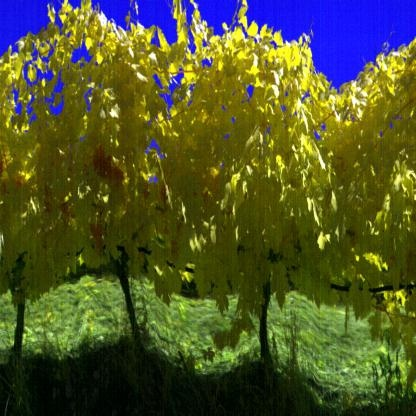

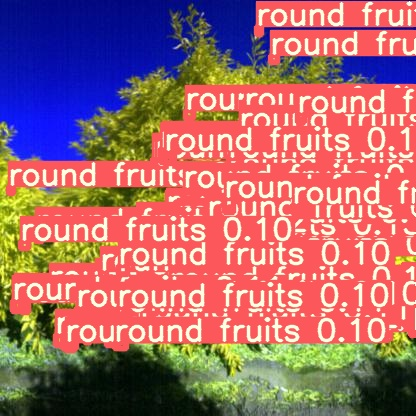

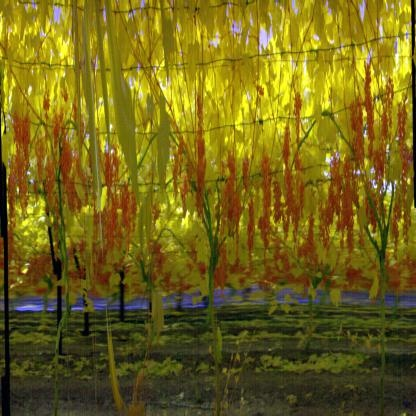

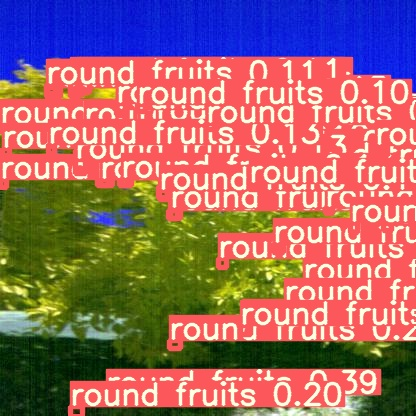

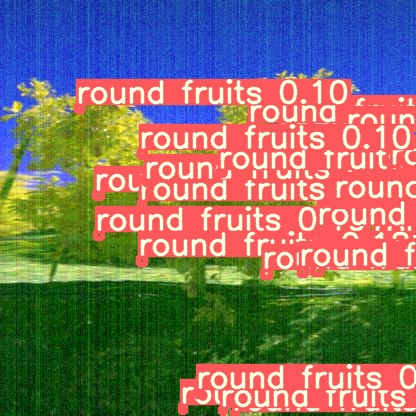

...

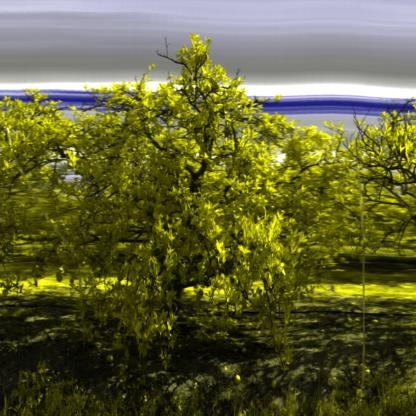

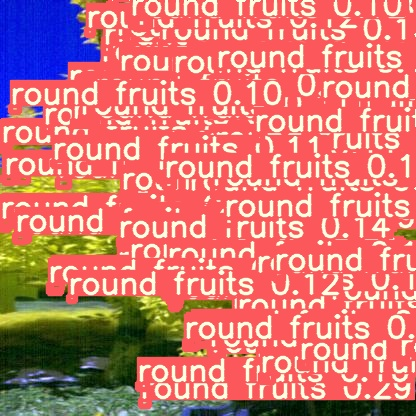

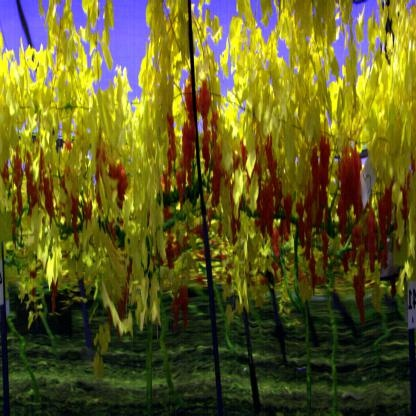

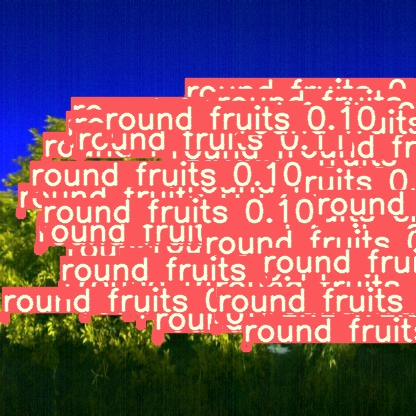

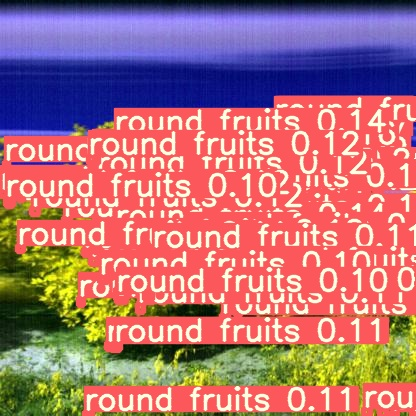

In [19]:
#display inference on ALL test images
#this looks much better with longer training above

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/inference/output/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

# Export Trained Weights for Future Inference

Now that you have trained your custom detector, you can export the trained weights you have made here for inference on your device elsewhere

In [20]:
from google.colab import drive
drive.mount('/content/gdrive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /content/gdrive


In [24]:
%cp /content/yolov5/runs/exp2_yolov5s_results/weights/best_yolov5s_results.pt /content/gdrive/My\ Drive

## Congrats!

Hope you enjoyed this!

--Team [Roboflow](https://roboflow.ai)